In [92]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
sns.set_style("whitegrid")
from tqdm import tqdm
import random
import math as m
import string
from collections import defaultdict
from pre_processing import word_count, unique_words , stop_words_count , chart_count , mean_word_length, punctuation_count
from nltk.corpus import stopwords
import preprocessing as pp

In [2]:
import plotly.graph_objects as go

import plotly.io as pio
from IPython.display import Image

In [3]:
import plotly as py
from plotly.offline import iplot
py.offline.init_notebook_mode(connected=True)
import cufflinks as cf
cf.go_offline()

In [4]:
df=pd.read_csv("df.csv")
df.head()

,designation,description,productid,imageid,prdtypecode,target,image_path
0,Olivia: Personalisiertes Notizbuch / 150 Seite...,NaN,3804725264,1263597046,10,0,image_1263597046_product_3804725264.jpg
1,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,NaN,436067568,1008141237,2280,1,image_1008141237_product_436067568.jpg
2,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,PILOT STYLE Touch Pen de marque Speedlink est ...,201115110,938777978,50,2,image_938777978_product_201115110.jpg
3,Peluche Donald - Europe - Disneyland 2000 (Mar...,NaN,50418756,457047496,1280,3,image_457047496_product_50418756.jpg
4,La Guerre Des Tuques,Luc a des id&eacute;es de grandeur. Il veut or...,278535884,1077757786,2705,4,image_1077757786_product_278535884.jpg


# Création de colonnes supplémentaires pour l'exploration de données 

In [5]:
df['word_count_description'] = df['description'].apply(word_count)
df['word_count_designation'] = df['designation'].apply(word_count)

In [6]:
df['unique_word_count_description'] = df['description'].apply(unique_words)
df['unique_word_count_designation'] = df['designation'].apply(unique_words)

In [7]:
df['chart_count_description'] = df['description'].apply(chart_count)
df['chart_count_designation'] = df['designation'].apply(chart_count)

In [8]:
df['stop_words_count_description'] = df['description'].apply(stop_words_count)
df['stop_words_count_designation'] = df['designation'].apply(stop_words_count)

In [9]:
df['mean_word_length_description'] = df['description'].apply(mean_word_length)
df['mean_word_length_designation'] = df['designation'].apply(mean_word_length)

In [10]:
df['punctuation_count_description'] = df['description'].apply(punctuation_count)
df['punctuation_count_designation'] = df['designation'].apply(punctuation_count)

In [11]:
df.head(3)

,designation,description,productid,imageid,prdtypecode,target,image_path,word_count_description,word_count_designation,unique_word_count_description,unique_word_count_designation,chart_count_description,chart_count_designation,stop_words_count_description,stop_words_count_designation,mean_word_length_description,mean_word_length_designation,punctuation_count_description,punctuation_count_designation
0,Olivia: Personalisiertes Notizbuch / 150 Seite...,NaN,3804725264,1263597046,10,0,image_1263597046_product_3804725264.jpg,NaN,14,NaN,11,NaN,88,NaN,0,NaN,11,NaN,6
1,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,NaN,436067568,1008141237,2280,1,image_1008141237_product_436067568.jpg,NaN,39,NaN,34,NaN,206,NaN,9,NaN,34,NaN,12
2,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,PILOT STYLE Touch Pen de marque Speedlink est ...,201115110,938777978,50,2,image_938777978_product_201115110.jpg,109.0,12,88.0,12,760.0,76,31.0,0,88.0,12,51.0,1


# Premières analyses

In [12]:
description_stats=['word_count_description' ,'unique_word_count_description','chart_count_description','stop_words_count_description','mean_word_length_description','punctuation_count_description']
designation_stats=['word_count_designation' ,'unique_word_count_designation','chart_count_designation','stop_words_count_designation','mean_word_length_designation','punctuation_count_designation']


In [32]:
df[designation_stats].iplot(kind='box', title= "Statistiques de la variables designation",display_image=True)


No handles with labels found to put in legend.


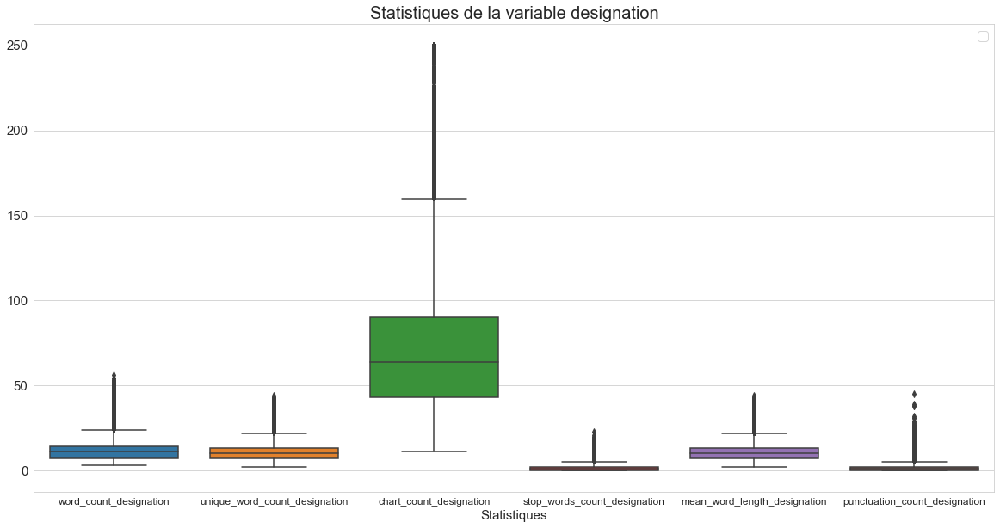

In [29]:
plt.figure(figsize=(20,10))
sns.boxplot(data=df[designation_stats])
plt.legend(fontsize=15)
plt.title("Statistiques de la variable designation", fontsize=20)
plt.xlabel("Statistiques", fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=15)
plt.show()

In [18]:
df[description_stats].iplot(kind='box', title= "Statistiques de la variable description")

No handles with labels found to put in legend.


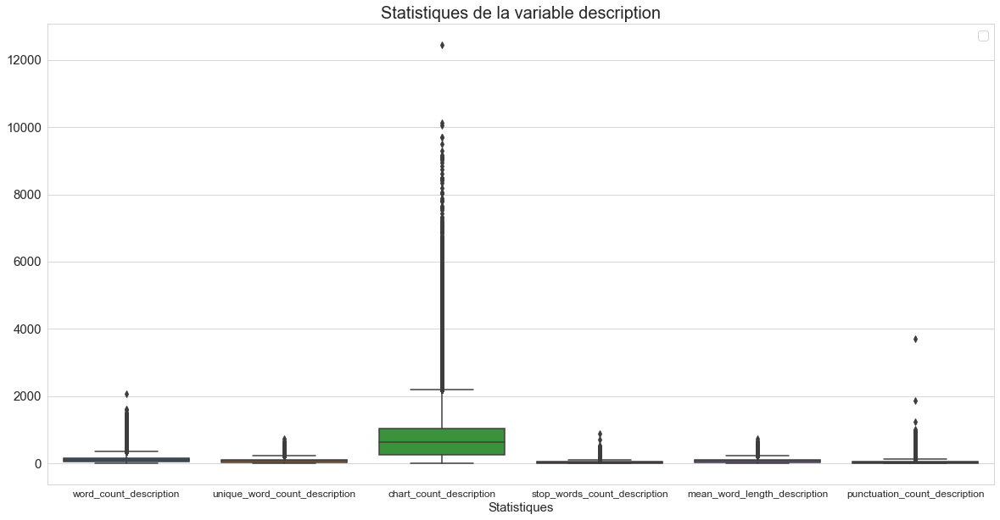

In [30]:
plt.figure(figsize=(20,10))
sns.boxplot(data=df[description_stats])
plt.legend(fontsize=15)
plt.title("Statistiques de la variable description", fontsize=20)
plt.xlabel("Statistiques", fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=15)
plt.show()

### On remarque que la colonne description (sans tenir compte des NaNs) a globalement beaucoup plus de mots que la colonne designation. 

### Le graphique ci-dessous compare les nombres de mots et les nombres de mots uniques de chacune des variables.

In [31]:
word_count=df[[x for x in df.columns if "word_count" in x]]

In [32]:
word_count.iplot(kind='box', title= "word counts for both designation and description")

No handles with labels found to put in legend.


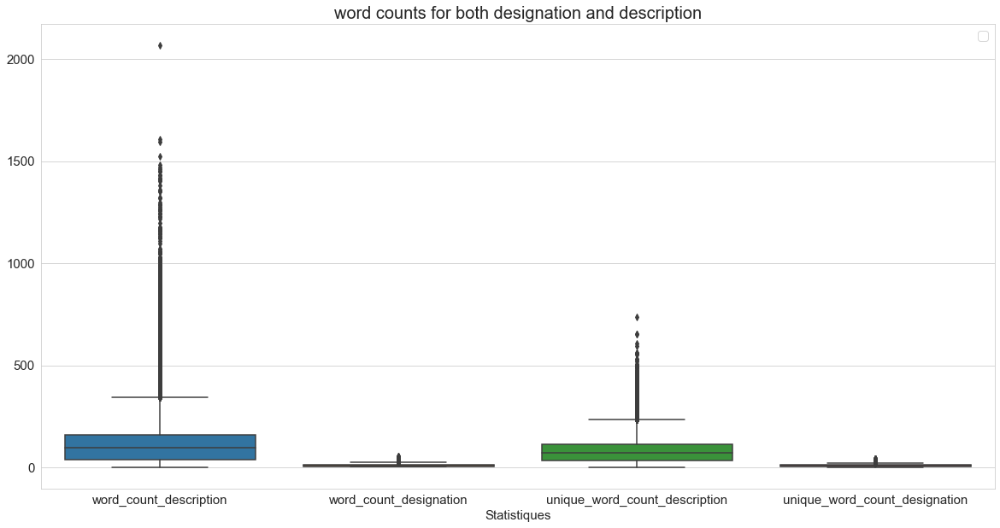

In [34]:
plt.figure(figsize=(20,10))
sns.boxplot(data=word_count)
plt.legend(fontsize=15)
plt.title("word counts for both designation and description", fontsize=20)
plt.xlabel("Statistiques", fontsize=15)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.show()

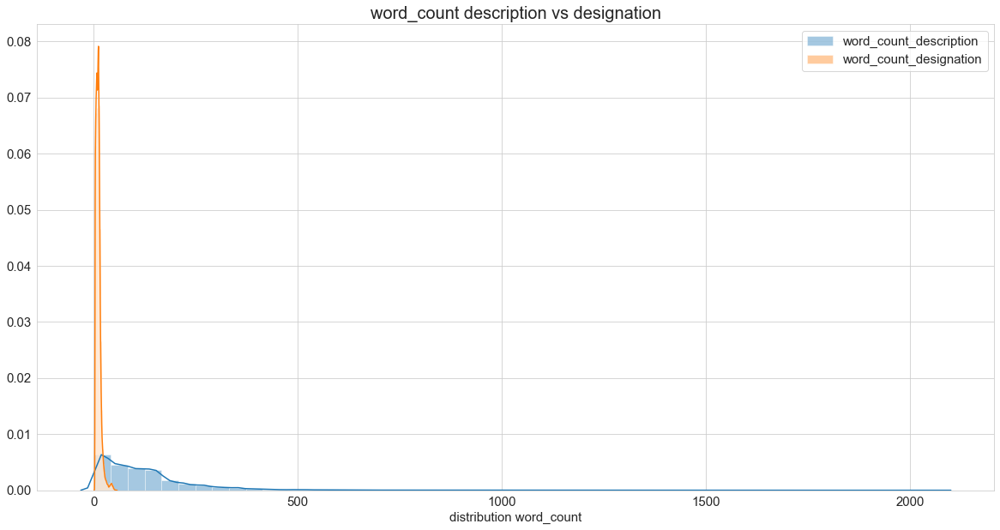

In [35]:
plt.figure(figsize=(20,10))
sns.distplot(word_count.iloc[:,0].values, label=word_count.columns[0])
sns.distplot(word_count.iloc[:,1].values,label=word_count.columns[1])
plt.legend(fontsize=15)
plt.title("word_count description vs designation", fontsize=20)
plt.xlabel("distribution word_count", fontsize=15)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.show()

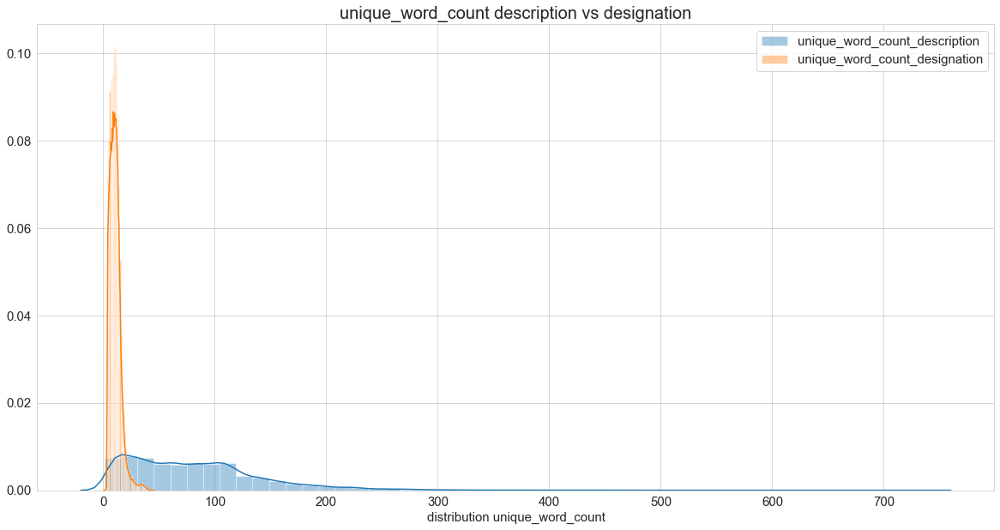

In [36]:
plt.figure(figsize=(20,10))
sns.distplot(word_count.iloc[:,2].values, label=word_count.columns[2])
sns.distplot(word_count.iloc[:,3].values,label=word_count.columns[3])
plt.legend(fontsize=15)
plt.title("unique_word_count description vs designation", fontsize=20)
plt.xlabel("distribution unique_word_count", fontsize=15)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.show()

In [37]:
display(df[description_stats].describe())
display(df[designation_stats].describe())

,word_count_description,unique_word_count_description,chart_count_description,stop_words_count_description,mean_word_length_description,punctuation_count_description
count,55116.000000,55116.000000,55116.000000,55116.000000,55116.000000,55116.000000
mean,123.510959,81.412113,808.171692,32.652587,81.412113,49.950287
std,123.158437,60.652455,805.462153,38.137597,60.652455,71.529329
min,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000
25%,39.000000,33.000000,259.000000,6.000000,33.000000,11.000000
50%,95.000000,72.000000,626.000000,22.000000,72.000000,27.000000
75%,161.000000,113.000000,1034.000000,47.000000,113.000000,60.000000
max,2068.000000,739.000000,12451.000000,888.000000,739.000000,3717.000000


,word_count_designation,unique_word_count_designation,chart_count_designation,stop_words_count_designation,mean_word_length_designation,punctuation_count_designation
count,84916.000000,84916.000000,84916.000000,84916.000000,84916.000000,84916.000000
mean,11.557374,10.706439,70.163303,1.483808,10.706439,1.829891
std,6.207966,5.051102,36.793383,1.881813,5.051102,2.602780
min,3.000000,2.000000,11.000000,0.000000,2.000000,0.000000
25%,7.000000,7.000000,43.000000,0.000000,7.000000,0.000000
50%,11.000000,10.000000,64.000000,1.000000,10.000000,1.000000
75%,14.000000,13.000000,90.000000,2.000000,13.000000,2.000000
max,56.000000,44.000000,250.000000,23.000000,44.000000,45.000000


- Cette comparaison entre les variables "description" et "designation" nous indique que la colonne description contient problablement beaucoup d'informations , malgré la quantité importantes de NaNs. Nous ne pouvons donc supprimer cette colonne dans le traitement des valeurs manquantes. 
- De plus si l'on fusionne ces deux colonnes sans échantillonner la colonne "description" , cela induira un biais pour le modèle NLP. Les lignes n'ayant pas de description auront une séquence textuelle beaucoup plus courte que les autres lignes  
- Cette analyse nous conduit à avoir deux startégie prossibles pour le preprocessing :   
1) On n'utilise que l'une ou l'autre des colonnes => Embedding  
2) On fusionne les deux colonnes :  
     a) Vectorisation( embedding) des deux colonnes   
     b) oversampling (SMOTE ?)   
     c) Fusion des colonnes (cela dépend de l'embedding ? )  


# Etude des N_grams

### Rappel répartition du dataset par target 

In [38]:
repartition=df[["designation", "target"]].groupby(['target'],as_index=False).count().sort_values("designation", ascending=False)

In [39]:
repartition.index=["cat_"+str(x) for x in repartition['target']]
repartition

,target,designation
cat_12,12,10209
cat_7,7,5073
cat_14,14,5045
cat_17,17,4993
cat_5,5,4989
cat_3,3,4870
cat_10,10,4774
cat_1,1,4760
cat_9,9,4303
cat_16,16,3953


No handles with labels found to put in legend.


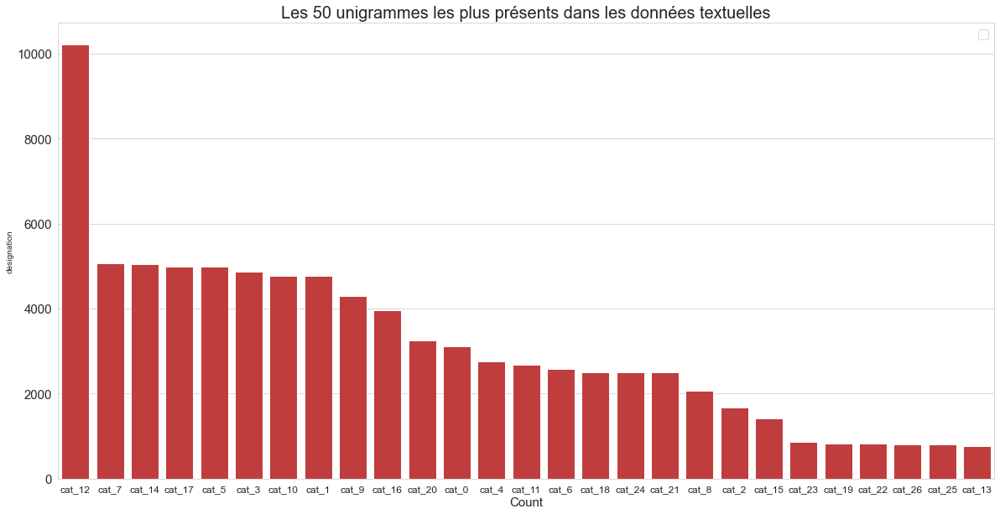

In [44]:
plt.figure(figsize=(20,10))
sns.barplot(y=repartition["designation"], x=repartition.index,color = "C3")
plt.legend(fontsize=15)
plt.title("Les 50 unigrammes les plus présents dans les données textuelles", fontsize=20)
plt.xlabel("Count", fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=15)
plt.show()

In [23]:
repartition['designation'].iplot(kind='bar', colors='red',xTitle="classes", yTitle="count",
                                title= "nb de lignes par classe")

### Data Cleaning : 

In [45]:
import re
import nltk
from nltk.stem.porter import PorterStemmer
from nltk.stem import WordNetLemmatizer

In [74]:
def remplace_accent(x):
    cd=pd.isnull(x)
    if cd==True:
        return x
    accent = ['é', 'è', 'ê', 'à', 'ù', 'û', 'ç', 'ô', 'î', 'ï', 'â','&acirc;','&agrave;','&eacute;','&ecirc;','&egrave;','&euml;','&icirc;','&iuml;','&ocirc;','&oelig;','&ucirc;','&ugrave;','&uuml;','&ccedil;','&lt;','&gt;','&szlig;','&oslash;','&Omega;','&ETH;','&Oslash;','&THORN;','&thorn;','&Aring;']
    sans_accent = ['e', 'e', 'e', 'a', 'u', 'u', 'c', 'o', 'i', 'i', 'a','a','a','e','e','e','e','i','i','o','oe','u','u','u','c',' ',' ','',' ',' ',' ',' ',' ',' ','A']

    for c, s in zip(accent, sans_accent):
        x = x.replace(c, s)
    return x

In [72]:
df["clean_designation"]=df["designation"].apply(remplace_accent)

In [75]:
df["clean_description"]=df["description"].apply(remplace_accent)

In [65]:
from nltk.stem.snowball import FrenchStemmer

stemmer = FrenchStemmer()

In [68]:
def cleaning_data(x):
    cd=pd.isnull(x)
    if cd==True:
        return x
    else:
        sentences = nltk.sent_tokenize(x)
        stemmer =  FrenchStemmer()

        # Lemmatization
        for i in range(len(sentences)):
            words = nltk.word_tokenize(sentences[i])
            words = [stemmer.stem(word) for word in words if word not in set(stopwords.words('french'))]
            sentences[i] = ' '.join(words) 
        sentences=' '.join(sentences)
        # on retire les balises html
        sentences=re.sub('<[^<]+?>', '', sentences)

        return sentences
     

In [81]:
df["stem_designation"]=df["clean_designation"].apply(cleaning_data)

df["stem_description"]=df["clean_description"].apply(cleaning_data)

In [ ]:
def drop_punctuation(x):
    cd=pd.isnull(x)
    if cd==True:
        return x
    elif "#&" in x:
        
    

In [83]:
df.to_csv("df_clean.csv",index=False)

In [84]:
df.head()

,designation,description,productid,imageid,prdtypecode,target,image_path,word_count_description,word_count_designation,unique_word_count_description,...,stop_words_count_description,stop_words_count_designation,mean_word_length_description,mean_word_length_designation,punctuation_count_description,punctuation_count_designation,clean_designation,clean_description,stem_designation,stem_description
0,Olivia: Personalisiertes Notizbuch / 150 Seite...,NaN,3804725264,1263597046,10,0,image_1263597046_product_3804725264.jpg,NaN,14,NaN,...,NaN,0,NaN,11,NaN,6,Olivia: Personalisiertes Notizbuch / 150 Seite...,NaN,olivi personalisiert notizbuch 150 seiten p...,NaN
1,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,NaN,436067568,1008141237,2280,1,image_1008141237_product_436067568.jpg,NaN,39,NaN,...,NaN,9,NaN,34,NaN,12,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,NaN,journal de art le n 133 du 28092001 lart et...,NaN
2,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,PILOT STYLE Touch Pen de marque Speedlink est ...,201115110,938777978,50,2,image_938777978_product_201115110.jpg,109.0,12,88.0,...,31.0,0,88.0,12,51.0,1,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,PILOT STYLE Touch Pen de marque Speedlink est ...,grand stylet ergonom bleu gamepad nintendo wii...,pilot styl touch pen marqu speedlink 1 stylet ...
3,Peluche Donald - Europe - Disneyland 2000 (Mar...,NaN,50418756,457047496,1280,3,image_457047496_product_50418756.jpg,NaN,10,NaN,...,NaN,1,NaN,9,NaN,4,Peluche Donald - Europe - Disneyland 2000 (Mar...,NaN,peluch donald europ disneyland 2000 marionn...,NaN
4,La Guerre Des Tuques,Luc a des id&eacute;es de grandeur. Il veut or...,278535884,1077757786,2705,4,image_1077757786_product_278535884.jpg,34.0,4,30.0,...,14.0,2,30.0,4,15.0,0,La Guerre Des Tuques,Luc a des idees de grandeur. Il veut organiser...,la guerr de tuqu,luc a ide grandeur il veut organis jeu guerr ...


### Text entier Corpus

### Fusion des colonnes description & designation pour avoir toutes les données text

In [93]:
def corpus(x,y):
    cx=pd.isnull(x)
    cy=pd.isnull(y)
    if cx==True:
        return y
    elif cy==True:
        return x
    else :
        return x+y 
    

In [111]:
def plot_ngrams(dict_ngram,size=50, title="Les 50 unigrammes les plus présents dans les données textuelles", color="C3", figsize=(20,10)):
    keys = list(dict_ngram.keys())
    vals = [dict_ngram[k] for k in keys]
    ngrams=pd.DataFrame( columns=['ngrams', "count"])
    ngrams['ngrams']=keys
    ngrams['count']=vals
    ngrams = ngrams.sort_values(['count'], ascending=False).reset_index(drop=True)
    plt.figure(figsize=figsize)
    sns.barplot(y=ngrams['ngrams'][:size], x=ngrams['count'][:size],color = color)
    plt.legend(fontsize=15)
    plt.title(title, fontsize=20)
    plt.xlabel("Count", fontsize=15)
    plt.ylabel("ngrams", fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    plt.show()

In [95]:
df['clean_corpus']=df.apply(lambda x: corpus(x['clean_description'], x['clean_designation']), axis=1)

In [97]:
df['stem_corpus']=df.apply(lambda x: corpus(x['stem_description'], x['stem_designation']), axis=1)

In [98]:
df.head(3)

,designation,description,productid,imageid,prdtypecode,target,image_path,word_count_description,word_count_designation,unique_word_count_description,...,mean_word_length_description,mean_word_length_designation,punctuation_count_description,punctuation_count_designation,clean_designation,clean_description,stem_designation,stem_description,clean_corpus,stem_corpus
0,Olivia: Personalisiertes Notizbuch / 150 Seite...,NaN,3804725264,1263597046,10,0,image_1263597046_product_3804725264.jpg,NaN,14,NaN,...,NaN,11,NaN,6,Olivia: Personalisiertes Notizbuch / 150 Seite...,NaN,olivi personalisiert notizbuch 150 seiten p...,NaN,Olivia: Personalisiertes Notizbuch / 150 Seite...,olivi personalisiert notizbuch 150 seiten p...
1,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,NaN,436067568,1008141237,2280,1,image_1008141237_product_436067568.jpg,NaN,39,NaN,...,NaN,34,NaN,12,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,NaN,journal de art le n 133 du 28092001 lart et...,NaN,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,journal de art le n 133 du 28092001 lart et...
2,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,PILOT STYLE Touch Pen de marque Speedlink est ...,201115110,938777978,50,2,image_938777978_product_201115110.jpg,109.0,12,88.0,...,88.0,12,51.0,1,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,PILOT STYLE Touch Pen de marque Speedlink est ...,grand stylet ergonom bleu gamepad nintendo wii...,pilot styl touch pen marqu speedlink 1 stylet ...,PILOT STYLE Touch Pen de marque Speedlink est ...,pilot styl touch pen marqu speedlink 1 stylet ...


In [100]:

clean_corpus=' '.join(df['clean_corpus'].tolist())
stem_corpus=' '.join(df['stem_corpus'].tolist())


In [134]:
def generate_ngrams(text, n_gram=1):
    stop_words=stopwords.words('french')+['&',"#",";","a","e"]+[str(i) for i in range(32,48)]
    token = [token for token in text.lower().split(' ') if token != '' if token not in set(stop_words)]
    ngrams = zip(*[token[i:] for i in range(n_gram)])
    return [' '.join(ngram) for ngram in ngrams]

In [105]:
unigrams_corpus =defaultdict(int) 
for text in df['stem_corpus']:
    for word in generate_ngrams(text):
        unigrams_corpus[word] += 1

In [106]:
bigrams_corpus =defaultdict(int) 
for text in df['stem_corpus']:
    for word in generate_ngrams(text,2):
        bigrams_corpus[word] += 1


No handles with labels found to put in legend.


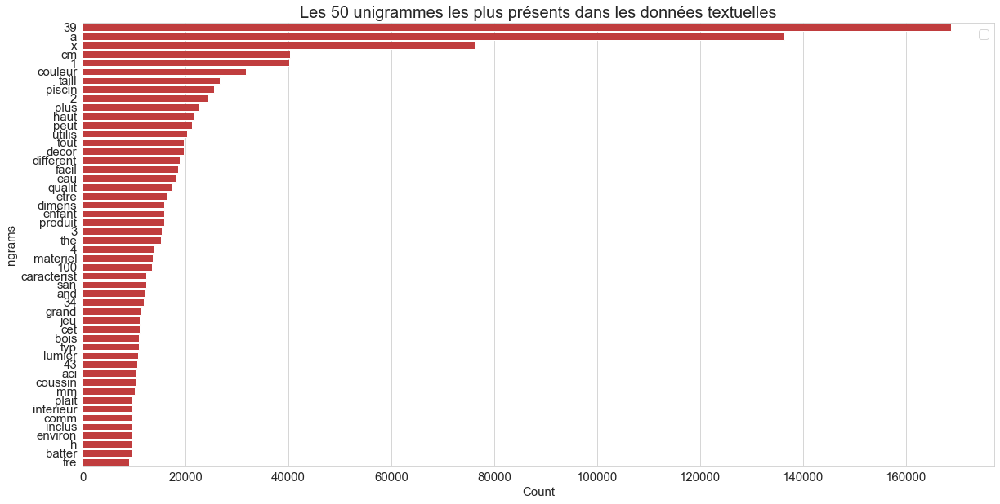

In [112]:
plot_ngrams(unigrams_corpus)

No handles with labels found to put in legend.


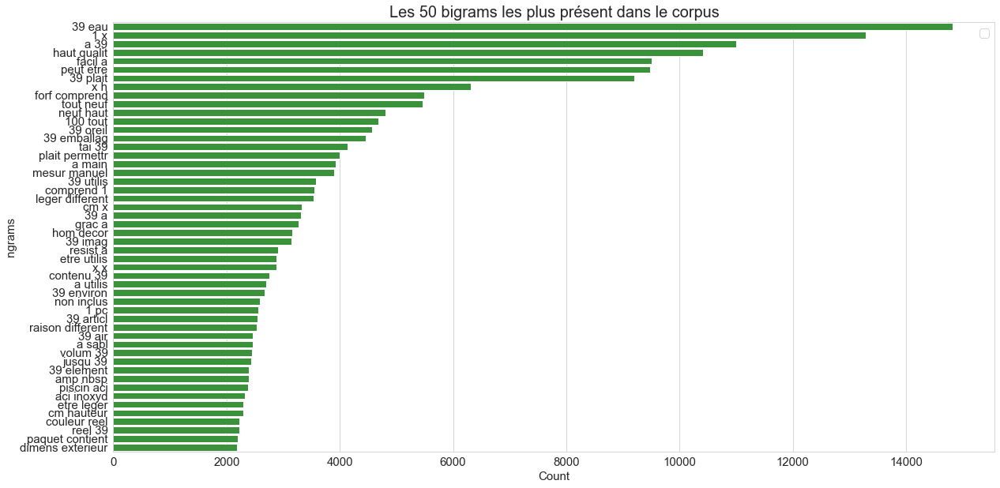

In [113]:
plot_ngrams(bigrams_corpus, title="Les 50 bigrams les plus présent dans le corpus", color="C2")


#### Ces analyses on été réalisées sur les données nettoyées (avec la fonction vue plus haut).
Cependant on peut remarquer qu'il y a encore du nettoyage à faire "39" qui provient de "bigrams_corpus "&#39" et qui correspond à l'apostrophe 

#### Unigrams et bigrams par classe

In [136]:
# Unigrams
unigrams_per_class ={}
for target in tqdm( df['target'].unique()):
    unigrams_per_class[target]=defaultdict(int)
   
    for text in df[df['target']==target]['stem_corpus'].dropna():
       
        for word in generate_ngrams(text):
            
            unigrams_per_class[target][word] += 1

# bigrams
bigrams_per_class ={}
for target in tqdm( df['target'].unique()):
    bigrams_per_class[target]=defaultdict(int)
   
    for text in df[df['target']==target]['stem_corpus'].dropna():
       
        for word in generate_ngrams(text,2):
            
            bigrams_per_class[target][word] += 1

100%|██████████████████████████████████████████████████████████████████████████████████| 27/27 [00:35<00:00,  1.33s/it]


#### Unigrams par class e

In [141]:
def plot_ngrams_class(ngrams_dict, title="unigrams", size=10,subplots=[14,2], color="C3", figsize=(14,70)):
    fig = plt.figure(figsize=figsize)

    a = subplots[0]  # number of rows
    b = subplots[1]  # number of columns
    c = 1
    for i, key in enumerate(list(ngrams_dict.keys())):
        keys = list(ngrams_dict[key].keys())
        vals = [ngrams_dict[key][mot] for mot in keys]
        grams_df=pd.DataFrame( columns=['grams', "count"])
        grams_df['grams']=keys
        grams_df['count']=vals
        grams_df = grams_df.sort_values(['count'], ascending=False).reset_index(drop=True)
        plt.subplot(a, b, c)
        sns.barplot( y=grams_df['grams'][:size], x=grams_df['count'][:size], color=color)
        plt.title(title+"_cat_"+str(key))
        c+=1

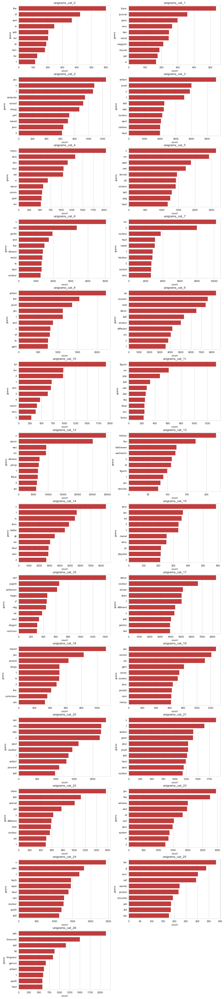

In [142]:
plot_ngrams_class(unigrams_per_class, title="unigrams", size=10,subplots=[14,2], color="C3", figsize=(14,70))

### Remarques 

1. On remarque que certaines catégories contiennent principalement des mots en anglais (classe 0). 
2. D'autres classes se distinguent bien par des unigrams différents des autres, comme les classes 1 , 3, 9, 11, 13, 16 , 25.
3. On peut remarquer qu'il y a encore du nettoyage à faire dans les données. Il faudrait retirer les mots : x, cm, jeu , 1, and , of, the.
4. Certaines classes partagent des unigrams avec d'autres. Voyons si avec des bigrams on arrive à un meilleur résultat.

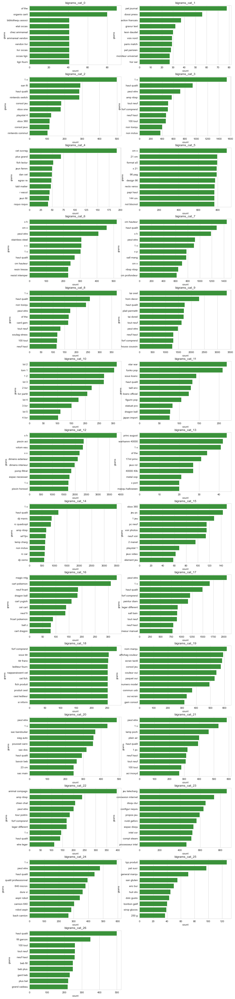

In [143]:
plot_ngrams_class(bigrams_per_class, title="bigrams", color="C2")

Les bigrams donnent une meilleure caractérisation par classe.  
L'analyse des bigrams confirme le nettoyage des "x", "1", qui sont présents dans plusieurs catégories, et n'apportent donc aucune information pertinente pour la classification.

# Designation vs Description : quelles colonne donne le plus d'information ?

In [145]:
# bigrams_description
bigrams_desc_per_class ={}
for target in tqdm( df['target'].unique()):
    bigrams_desc_per_class[target]=defaultdict(int)
   
    for text in df[df['target']==target]['stem_description'].dropna():
       
        for word in generate_ngrams(text):
            
            bigrams_desc_per_class[target][word] += 1

# bigrams
bigrams_desi_per_class ={}
for target in tqdm( df['target'].unique()):
    bigrams_desi_per_class[target]=defaultdict(int)
   
    for text in df[df['target']==target]['stem_designation'].dropna():
       
        for word in generate_ngrams(text,2):
            
            bigrams_desi_per_class[target][word] += 1

100%|██████████████████████████████████████████████████████████████████████████████████| 27/27 [00:21<00:00,  1.26it/s]


#### Bigrams par classe de description :

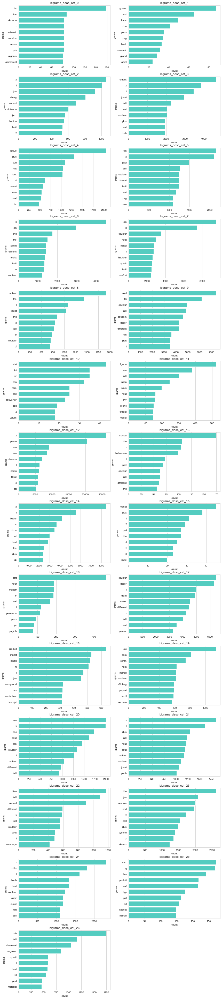

In [146]:
plot_ngrams_class(bigrams_desc_per_class, title="bigrams_desc", color="turquoise")

#### Bigrams par classe de designation

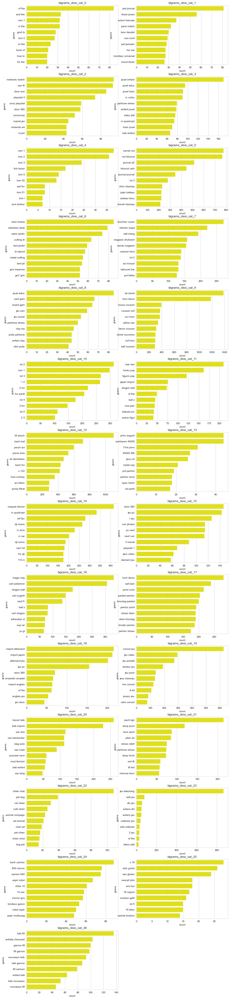

In [147]:
plot_ngrams_class(bigrams_desi_per_class, title="bigrams_desi", color="yellow")

## Conclusion pour la partie texte

La colonne 'description' est celle qui contient le plus de bruit avec des mots inutiles, mais c'est celle qui contient le plus de données par ligne.  
La colonnes designation quant à elle contient des données plus propres, les bigrammes obtenus caractérisent assez bien les classes. Les données de cette colonne sont d'une meilleure qualité, mais sont-elles suffisantes ?  
Réflexion : devrons-nous entrainer également notre modèle uniquement avec la colonne 'designation' ?